In [1]:
import pandas as pd

file_path = './content/Вводы-data-as-joinbyfield-2024-07-23 12_26_58.csv'
data = pd.read_csv(file_path)

data.head()


,Time,Ввод 2 суммарный,Ввод 1 суммарный___
0,2020-06-22 11:00:00,47248,50533
1,2020-06-22 12:00:00,44469,48962
2,2020-06-22 13:00:00,49536,45790
3,2020-06-22 14:00:00,50336,44758
4,2020-06-22 15:00:00,50655,43360


In [2]:
data['Time'] = pd.to_datetime(data['Time'])

data['Hour'] = data['Time'].dt.hour
data['DayOfWeek'] = data['Time'].dt.dayofweek
data['DayOfMonth'] = data['Time'].dt.day
data['Month'] = data['Time'].dt.month
data['Year'] = data['Time'].dt.year

data['Total Consumption'] = (data['Ввод 1 суммарный___'] + data['Ввод 2 суммарный']) /1000

data.head()


,Time,Ввод 2 суммарный,Ввод 1 суммарный___,Hour,DayOfWeek,DayOfMonth,Month,Year,Total Consumption
0,2020-06-22 11:00:00,47248,50533,11,0,22,6,2020,97.781
1,2020-06-22 12:00:00,44469,48962,12,0,22,6,2020,93.431
2,2020-06-22 13:00:00,49536,45790,13,0,22,6,2020,95.326
3,2020-06-22 14:00:00,50336,44758,14,0,22,6,2020,95.094
4,2020-06-22 15:00:00,50655,43360,15,0,22,6,2020,94.015


13:02:45 - cmdstanpy - INFO - Chain [1] start processing
13:02:56 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/2 [00:00<?, ?it/s]

13:03:01 - cmdstanpy - INFO - Chain [1] start processing
13:03:03 - cmdstanpy - INFO - Chain [1] done processing
13:03:04 - cmdstanpy - INFO - Chain [1] start processing
13:03:11 - cmdstanpy - INFO - Chain [1] done processing


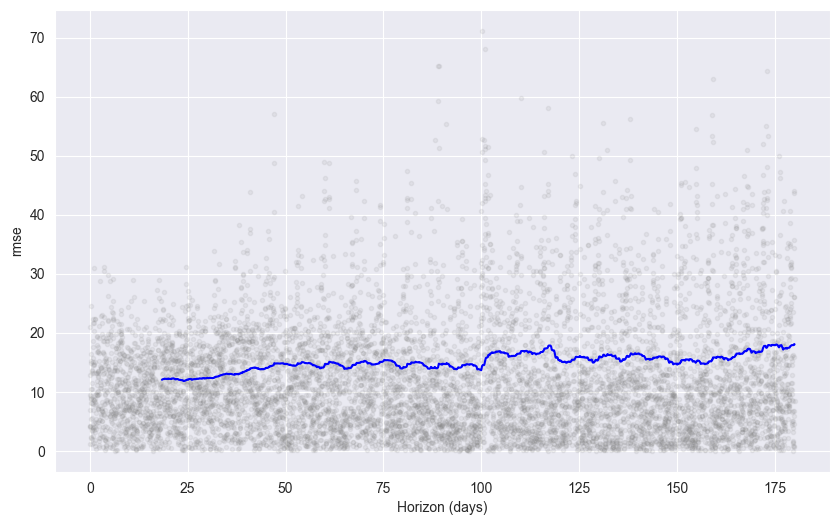

In [3]:
import warnings
warnings.filterwarnings('ignore')
import prophet
from prophet.plot import plot_plotly, plot_components_plotly
from prophet.diagnostics import cross_validation
from prophet.plot import plot_cross_validation_metric

prophet_data = data[['Time', 'Total Consumption']].rename(columns={'Time': 'ds', 'Total Consumption': 'y'})

model = prophet.Prophet()

model.fit(prophet_data)

future_dates = model.make_future_dataframe(periods=365*24, freq='h', include_history=True)

forecast = model.predict(future_dates)

fig = plot_plotly(model, forecast)
fig.update_layout(
    title='Прогноз потребления',
    xaxis_title='Дата',
    yaxis_title='Потребление',
    legend_title='Легенда',
    template='plotly_white'
)
fig.show()

df_cv = cross_validation(model, initial='450 days', period='365 days', horizon = '180 days')
fig = plot_cross_validation_metric(df_cv, metric='rmse')
fig.show()

fig = plot_components_plotly(model, forecast)
fig.show()